In [5]:
"""
Create Your Own N-body Simulation (With Python)
Adapted from Philip Mocz (2020) Princeton University, @PMocz
New structure, Initial condition module, movie module, rotational analysis, comments: C.Welker

Deactivate movie module if not willing to install moviepy, which is sometimes tricky

Simulate orbits of particles interacting only through gravitational interactions
Code calculates pairwise forces according to Newton's Law of Gravity. 
Note that there is no expansion in this simulation. We are focusing on patch decoupled from
expansion. Let's see how long it takes to virialize once a structure is collapsing.
Of course in a real simulation with billions of particles, we will need some good approximation 
to NOT calculate all pairwise interactions (Yes, it will have a lot do with finding mesoscale "pixels"!). 
But for now, let's focus on a few hundreds particles
"""
import numpy as np
import matplotlib.pyplot as plt
import os
#import moviepy.video.io.ImageSequenceClip
#from natsort import natsorted

In [7]:
def ScaleFactor(t):
    # --------------This module computes a scale factor at time t in the LCDM, matter dominated era.
    # useful if you want to include expansion
    a =  (t+0.3)**(2.0/3.0)
    return a

In [9]:
#Initial Conditions Module
def InitialConditions(N,omega,mtot,v0):
    
    # --------------This module generates Initial Conditions
    #For N particles with total mass mtot and solid angular velocity omega
    
    np.random.seed(17)            # set the random number generator seed
    
    mass = mtot*np.ones((N,1))/N  # total mass of particles is mtot. all particles have the same mass
    pos  = np.random.randn(N,3)   # randomly selected positions and velocities
    
    if(v0==1):
        # for solid rotation: Vrot=radius*omega along e_theta. Let's calculate the radii of particles first
        x = pos[:,0:1]
        y = pos[:,1:2]
        z = pos[:,2:3]
        # in the frame of the centre of mass
        x -= np.mean(mass * x) / np.mean(mass)
        y -= np.mean(mass * y) / np.mean(mass)
        z -= np.mean(mass * z) / np.mean(mass)
        #polar coordinates (r, theta,z). We consider z the axis of rotation
        norm_r=np.sqrt(x**2 + y**2)
        theta=np.arctan(y/x)
        #total rotational velocity, tangential to radius. Let assume the axis of rotation is z
        vrot=norm_r*omega
        vrot_x=-vrot*np.sin(theta)
        vrot_y=vrot*np.cos(theta)
        vrot_z=np.zeros(N)
        vrot_z=vrot_z.reshape(N,1)
        vrot=np.hstack((vrot_x,vrot_y,vrot_z))
    
        vel  =  np.random.randn(N,3) 
        # in the frame of the centre of mass
        vel -= np.mean(mass * vel,0) / np.mean(mass)
        #vrot and random variation
        vel=vel+vrot
    else:
        vel=np.zeros((N,3))    
       # --------------
    
    return mass, pos, vel

In [11]:
#Let's define all the functions we need!

def getAcc( pos, mass, G, softening,t ):
    """
    Calculate the acceleration on each particle due to Newton's Law 
    pos  is the N x 3 matrix of positions
    mass is the N x 1 vector of masses
    G is Newton's Gravitational constant
    softening is the softening length added to the potential, to avoid NaNs. 
    This sets the resolution of the simulation
    a is the N x 3 matrix of accelerations
    NOTE: You can see that everything is put in matrix form, allowing for matrix operations rather than looping over particles 
    to get each update. This is not just because it looks cool to do all calculations in only one line rather than a FOR loop. 
    It  also significantly improves the computational performance in python!!
    """
    # positions r = [x,y,z] for all particles
    x = pos[:,0:1]
    y = pos[:,1:2]
    z = pos[:,2:3]
    
    # matrix that stores all pairwise particle separations: r_j - r_i
    dx = x.T - x
    dy = y.T - y
    dz = z.T - z

    # matrix that stores 1/r^3 for all particle pairwise particle separations 
    """
    You can see that we included a "softening term". Its goal is to avoid getting an (near)infinite value when distance
    between two particles is ~ zero. It can happen in simulations where resolution, 
    number of particles and float precision is limited but would be unphysical. 
    We've seen that close-encounter collisions are rather irrelevant in collisionless systems likes haloes.
    So softening is essentially a user-defined resolution limit for numerical gravity. 
    """

    inv_r3 = (dx**2 + dy**2 + dz**2 + softening**2)
    inv_r3[inv_r3>0] = inv_r3[inv_r3>0]**(-1.5)
    
    # acceleration under gravity (Newton's second law) (notice we are calculating vec(r)/r^3 instead or 1/r^2 as we need the
    #direction of the force for each pair of particles)
    a=ScaleFactor(t) #adds expansion of the universe
    a=a**(-1.0)
    ax = G * a*(dx * inv_r3) @ mass
    ay = G * a*(dy * inv_r3) @ mass
    az = G * a*(dz * inv_r3) @ mass
    
    # pack together the acceleration components (hstack performs a concatenation)
    a = np.hstack((ax,ay,az))

    return a

def getEnergy( pos, vel, mass, G ):
    """
    Get kinetic energy (KE) and potential energy (PE) of simulation
    pos is N x 3 matrix of positions
    vel is N x 3 matrix of velocities
    mass is an N x 1 vector of masses
    G is Newton's Gravitational constant
    KE is the kinetic energy of the system
    PE is the potential energy of the system
    """
    # Kinetic Energy:
    KE = 0.5 * np.sum(np.sum( mass * vel**2 ))
    # Potential Energy:
    
    # positions r = [x,y,z] for all particles
    x = pos[:,0:1]
    y = pos[:,1:2]
    z = pos[:,2:3]
    
    # matrix that stores all pairwise particle separations: r_j - r_i. Note that each pair appears twice: dx(i,j)=-dx(j,i)
    dx = x.T - x
    dy = y.T - y
    dz = z.T - z

    # matrix that stores 1/r for all particle pairwise particle separations 
    inv_r = np.sqrt(dx**2 + dy**2 + dz**2)
    inv_r[inv_r>0] = 1.0/inv_r[inv_r>0]
    
    # sum over upper triangle, to count each interaction only once
    PE = G * np.sum(np.sum(np.triu(-(mass*mass.T)*inv_r,1)))
    
    #Radial kinetic energy: first Convert to Center-of-Mass frame
    x -= np.mean(mass * x) / np.mean(mass)
    y -= np.mean(mass * y) / np.mean(mass)
    z -= np.mean(mass * z) / np.mean(mass)
    norm_r=np.sqrt(x**2 + y**2 + z**2)
    x1=x/norm_r
    y1=y/norm_r
    z1=z/norm_r
    r=np.hstack((x1,y1,z1))
    vel_r=np.sum(vel*r,axis=1)
    vr2=vel_r**2
    N=vr2.shape[0]
    vr2=np.reshape(vr2,(N,1))
    KE_rad = 0.5 * np.sum(mass * vr2,axis=0 )
    KE_rad=KE_rad.reshape(1)[0]
    
    #Orbital kinetic energy
    KE_orb=KE-KE_rad
    
    return KE, PE, KE_rad, KE_orb


In [20]:
#Now we are ready to define the main simulation program!

def main():
    """ N-body simulation """
    
    # Simulation parameters (Your choice!)----------------------------------------------------
    N         = 100    # Number of particles
    t         = 0      # current time of the simulation
    tEnd      = 10.0   # time at which simulation ends
    dt        = 0.01   # timestep
    softening = 0.1    # softening length
    G         = 1.0    # Newton's Gravitational Constant
    mtot      = 20.0  # Total mass of the object
    plotRealTime = True # switch on for plotting as the simulation goes along
    omega        = 0.0  # initial angular velocity if solid rotation
    v0           =0.0   #if not 1.0, set initial velocitites to 0
    #-------------------------------------------------------------------------------
    
    
    # Set where to store outputs-------------------------------------------------------------------------------    
    # Create a directory for the Simulation
    directory = "MyNbodyRun_Om"+str(omega)+"_N"+str(N)+"part"
    # Parent Directory path: change to your own path
    parent_dir = "/Users/charlottewelker/Desktop/NbodyMS/"
    isdir = os.path.isdir(parent_dir)
    if isdir==False: # create parent directory if it does not exist.
        os.mkdir(parent_dir)
    # Make complete Path
    path = os.path.join(parent_dir, directory)
    #Create directory
    isdir = os.path.isdir(path)
    if isdir==False:
        os.mkdir(path)
    #-----------------------------------------------------------------------------

    #Now let's run the simulation!
    mass,pos,vel = InitialConditions(N,omega,mtot,v0) #load initial conditions
    
    # calculate initial gravitational accelerations
    acc = getAcc( pos, mass, G, softening,0 )
    
    # calculate initial energy of system
    KE, PE, KE_rad, KE_orb  = getEnergy( pos, vel, mass, G )
    
    # number of timesteps
    Nt = int(np.ceil(tEnd/dt))
    
    # save energies, particle orbits for plotting trails
    pos_save = np.zeros((N,3,Nt+1))
    pos_save[:,:,0] = pos
    KE_save = np.zeros(Nt+1)
    KE_save[0] = KE
    PE_save = np.zeros(Nt+1)
    PE_save[0] = PE
    KE_Rsave = np.zeros(Nt+1)
    KE_Rsave[0] = KE_rad
    KE_Osave = np.zeros(Nt+1)
    KE_Osave[0] = KE_orb
    t_all = np.arange(Nt+1)*dt
    
    # prep figure
    fig = plt.figure(figsize=(4,5), dpi=80)
    grid = plt.GridSpec(3, 1, wspace=0.0, hspace=0.3)
    ax1 = plt.subplot(grid[0:2,0])
    ax2 = plt.subplot(grid[2,0])

    # Simulation Main Loop
    """
    We are using a numerical (=approximate) scheme to solve the equation of motion.
    The basic idea is that for each discrete timestep we calculate the acceleration at start time t and consider it constant
    during the timestep duration Dt. 
    So we can calculate the velocity and displacement of the particle easily. 
    
    With the simplest version of this (1 coarse timestep= 1 acceleration update, then 1 velocity update, then 1 "drift"
    (displacement) update across Dt), errors tend to pile up over timesteps and you end up far from the solution. 
    In othe words: the scheme is unstable (exercise: prove it! :-)
    
    A more stable scheme is used here, the kick-drift-kick version of the Leapfrog scheme. 
    Can you explain how it is different from the simple one?
    """
    for i in range(Nt):
        # (1/2) kick
        vel += acc * dt/2.0
        
        # drift
        pos += vel * dt
        
        # update accelerations
        acc = getAcc( pos, mass, G, softening,t )
        
        # (1/2) kick
        vel += acc * dt/2.0
        
        # update time
        t += dt
        
        # get energy of system
        KE, PE, KE_rad, KE_orb  = getEnergy( pos, vel, mass, G )
        
        # save energies, positions for plotting trail
        pos_save[:,:,i+1] = pos
        KE_save[i+1] = KE
        PE_save[i+1] = PE
        KE_Rsave[i+1] = KE_rad
        KE_Osave[i+1] = KE_orb
        
        # plot in real time
        if plotRealTime or (i == Nt-1):
            plt.sca(ax1)
            plt.cla()
            xx = pos_save[:,0,max(i-50,0):i+1]
            yy = pos_save[:,1,max(i-50,0):i+1]
            plt.scatter(xx,yy,s=1,color=[.7,.7,1])
            plt.scatter(pos[:,0],pos[:,1],s=10,color='red')
            ax1.set(xlim=(-2, 2), ylim=(-2, 2))
            ax1.set_aspect('equal', 'box')
            ax1.set_xticks([-2,-1,0,1,2])
            ax1.set_yticks([-2,-1,0,1,2])
            
            plt.sca(ax2)
            plt.cla()
            ax2.scatter(t_all,KE_save,color='red',s=1,label='KE')
            ax2.scatter(t_all,PE_save,color='blue',s=1,label='PE')
            ax2.scatter(t_all,KE_save+PE_save,color='black',s=1,label='Etot')
            ax2.scatter(t_all,2*KE_save+PE_save,color='pink',s=1,label='2KE+PE' )   
            ax2.scatter(t_all,KE_Rsave,color='green',s=1,label='KE_rad')
            ax2.scatter(t_all,KE_Osave,color='orange',s=1,label='KE_orb')
            ax2.legend(bbox_to_anchor=(1.35, 1.35), loc='upper right', borderaxespad=0)
            ax2.set(xlim=(0, tEnd+3), ylim=(-300, 300))
            ax2.set_aspect(0.005)
            
            # add labels/legend
            plt.sca(ax2)
            plt.xlabel('time')
            plt.ylabel('energy')
            
            plt.sca(ax1)
            plt.xlabel('x')
            plt.ylabel('y')
           
            
            #What can you say about the validity of the virial theorem vs that of the conservation of mechanical energy?
            # Save figure
            plt.savefig(str(path) +'/nbody_' + str(N) + 'part_omega' + str(omega) + '_step' + str(i) + '.png',dpi=240,  bbox_inches='tight', pad_inches = 0)
   
            plt.pause(0.001)
            
    plt.show()
    
    return 0




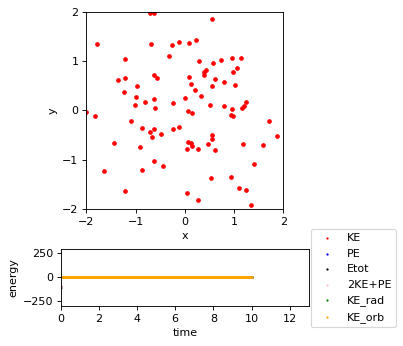

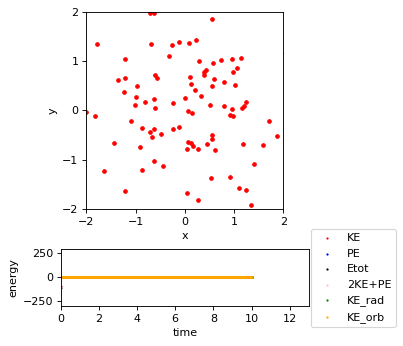

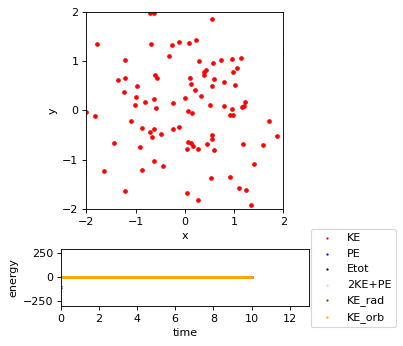

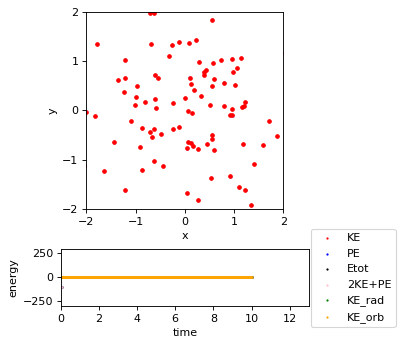

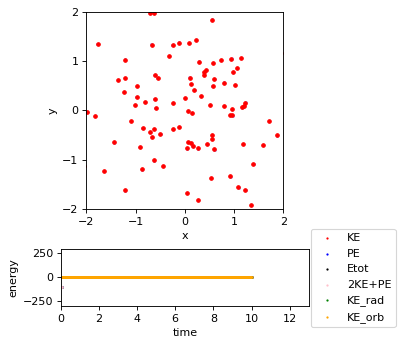

...

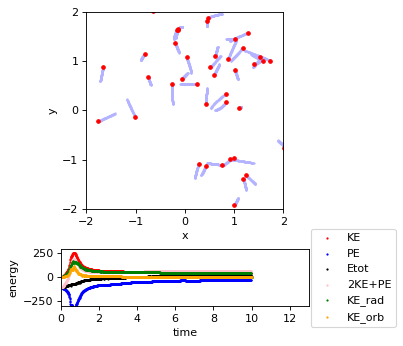

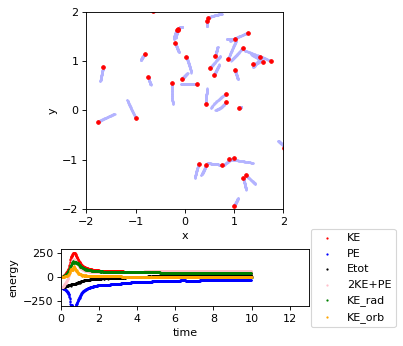

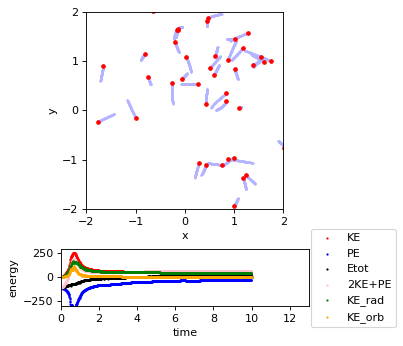

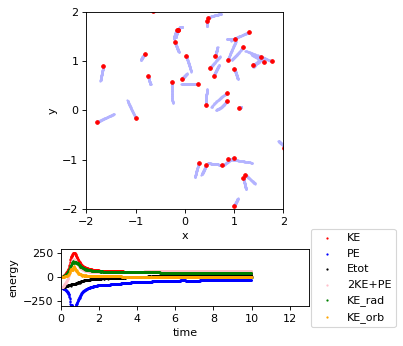

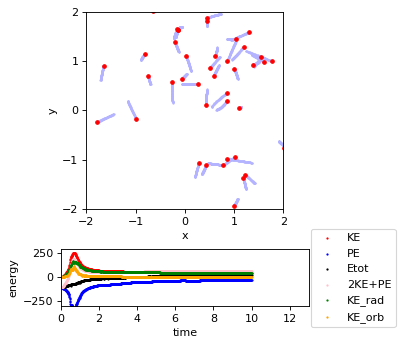

In [21]:
if __name__== "__main__":
  main()

In [22]:
# def make_movie(omega,N):
    
#     directory = "MyNbodyRun_Om"+str(omega)+"_N"+str(N)+"part"
#     # Parent Directory path: change to your own path
#     parent_dir = "/Users/charlottewelker/Desktop/NbodyMS/"
#     image_folder=os.path.join(parent_dir, directory)
    
#     fps=12 #number of frames per second
#     image_files = [os.path.join(image_folder,img)
#                    for img in os.listdir(image_folder)
#                    if img.endswith(".png")]
#     image_files_sorted = natsorted(image_files,reverse=False)
#     clip = moviepy.video.io.ImageSequenceClip.ImageSequenceClip(image_files_sorted, fps=fps)
#     clip.write_videofile(str(parent_dir) +'/nbody-cluster_Om'+str(omega)+'_N'+str(N)+'part.mp4')
#     return 0

In [23]:
# make_movie(0.0,100)

Moviepy - Building video /Users/charlottewelker/Desktop/NbodyMS//nbody-cluster0_Om0.0_N100part.mp4.
Moviepy - Writing video /Users/charlottewelker/Desktop/NbodyMS//nbody-cluster0_Om0.0_N100part.mp4



Moviepy - Done !
Moviepy - video ready /Users/charlottewelker/Desktop/NbodyMS//nbody-cluster0_Om0.0_N100part.mp4


0